# Reporte de Proyecto Final - Simulated Annealing (SA)

**Integrantes:**

* Brandon Francisco Hernández Troncoso
* José Eduardo Gutiérrez Navarrete
* Miguel Ángel Castañeda Martínez

## Objetivos:
* Entender el funcionamiento de SA 
* Replicar SA en una función de Python
* Probar SA en funciones conocidas (Parábola, Ackley y Coseno)
* Utilizar la funcion SA para resolver el problema del agente viajero

## Definición del Algoritmo
*Simulated annealing*, o recocido simulado en español, es un algoritmo metaheurístico propuesto por Kirkpatrick en la revista *Science* en 1983 (Kirkpatrick et al., 1983). En este artículo se muestra que el algoritmo puede resolver problemas de optimización tomando como base el conocimiento de la estadística mecánica y optimización combinatoria multivariada. Al igual que otros métodos metaheurísticos, SA está basado en un fenómeno causado por el proceso termodinámico de calentamiento y enfriamiento del recocido del metal, el cual permite deformar los materiales a temperaturas muy altas, pero conforme la temperatura se disminuye, el material resulta menos maleable y se deforma con menor facilidad (Press & Al, 2007). 

El algoritmo puede ser considerado como un punto medio entre el algoritmo de colinas ascendentes, que suele estancarse en mínimos locales, y algún otro algoritmo que se mueva de manera completamente aleatoria entre un conjunto de sucesores, el cual sería muy completo pero sumamente ineficiente. La intuición detrás de SA es que las primeras aproximaciones son mas descuidadas, es decir, que la probabilidad de aceptación de un movimiento "malo" es mas alta. Sin emabrgo, conforme el algoritmo se acerca al mínimo global, el algoritmo realiza movimientos más finos, lo que permite que la probabilidad de aceptación de un movimiento "malo" sea cada vez más baja, provocando de esta manera que se escojan mejores movimientos conforme se realizan las iteraciones (Liang, 2020). 

## Explicación del algoritmo

Como se mencionó anteriormente, SA toma su inspiración de la metalurgia, donde la temperatura es usada para controlar el grado de estocasticidad durante una búsqueda aleatoria. La temperatura se inicializa en un valor alto, permitiéndole al algoritmo poderse mover libremente sobre el espacio de búsqueda, en este caso la función a optimizar. Con lo anterior en mente, se tiene la esperanza de poder encontrar una región con el mejor mínimo local, el cuál se espera que sea equivalente al mínimo global. Sin embargo, para poder dicha región, también es necesario que la temperatura sea disminuida lentamente conforme se itera en el algoritmo, lo que permite reducir la estocasticidad y forza la búsqueda a converger a algún punto mínimo (Kochnderfer & Wheeler, 2019).

En cada iteración, un transición candidata de $x$ a $x'$ es muestrada de una distribución $T$ y es aceptada con probabilidad:

* $1$ si $\Delta y \leq 0$ 
* $exp(\frac{-\Delta y}{t})$ si $\Delta y > 0$

donde $\Delta y=f(x')-f(x)$ es la diferencia del objetivo y $t$ es la temperatura. 

Lo que vuelve a este algoritmo un método tan flexible es la aceptación de las probabilidades basado en el *crietrio Metropolis*, el cual ayuda al algoritmo a escapar de minimos locales cuando la temperatura es alta. Como es de esperarse, se requiere del parámetro que representa a la **temperatura** $t$, el cual controla la aceptación de la probabilidad, además de requerir de un **itinerario de recocido** que es usado para disminuir lentamente la temperatura conforme el algoritmo realiza las iteraciones, el cual también ayuda a lograr una convergencia con cada valor de temperatura disminuído (Kochnderfer & Wheeler, 2019).

Dentro de las restricciones que tiene este algoritmo destaca la velocidad con la que la temperatura debe ser disminuida, ya que si la temperatura disminuye su valor muy rápido, entonces la busqueda puede no llegar a converger a un mínino global, mientras que si la temperatura disminuye a un ritmo lento, entonces el algoritmo puede tomar mucho tiempo en converger. 

Existen varios tipos de itinerario de recocido (Kochnderfer & Wheeler, 2019), donde los más utilizados son:

* **logarítmico**: $t^{(k)}=t^{(1)}\frac{ln(2)}{ln(k+1)}$, 
* **exponencial**: $t^{(k+1)}=\gamma t^{(k)}$, $\gamma\in (0,1)$, 
* **recocido rápido**: $t^{(k)} = \frac{t^{(1)}}{k}$


Figura 1 - itinerarios de recocido 
<br> ![image](imagenes/Xnip2022-12-10_01-03-02.jpg)

## Análisis del problema de optimización a resolver

La intención de este trabajo al usar SA es demostrar su funcionamiento y eficacia ante problemas de optimización, donde buscamos encontrar puntos mínimos globales según las restricciones con las que se cuente. Para cumplir con este objetivo, se buscó poner a prubeba el método de SA para varias funciones definidas, las cuales se caracterizan por tener al menos un punto mínimo. Así mismo, se replicó la resolución del *problema del agente viajero*, el cual se explicará más tarde en este trabajo.

## ¿Qué tipo de problema de optimización es?

El problema que buscamos resolver es poder encontrar mínimos globales en funciones que se caracterizan por contener múltiples mínimos locales. De esta manera, buscamos aprovechar la ventaja de la **optimización estocástica** que caracteriza a SA, con la cual utilizamos aleatorización estratégica para explorar todo el espacio de la función de interés. Esta misma aleatoriedad que caracteriza a los métodos de optimización estocástica es lo que les ayuda a no quedarse estancados en puntos óptimos locales, brindando la capacidad de recorrer un mayor espacio de la función en búsqueda de los puntos óptimos globales con base en probabilidades de aceptación (Kochnderfer & Wheeler, 2019).

## Métodos alternativos

Dentro de la optimización estocástica existen varios métodos que nos pudieran ayudar a encontrar puntos mínimos globales, tales como *Gradiente descendente estocástico*, *Búsqueda directa adaptativa de malla*, o *entropía cruzada* (Kochnderfer & Wheeler, 2019). Cada uno de ellos posee ventajas que los hacen una opción viable, además de que son metodos que han sido estudiados por la comunidad y de los cuales es sencillo encontrar información. Sin embargo, después de una comparación entre los distintos tipos de algoritmos y un análisis de su respectiva implementación, se decidió que SA podría ser más intuitivo de entender, además de que el origen del algoritmo es del área de ingeniería, área de la que los integrantes de este equipo provienen, por lo que se tomó la decisión de replicar SA con base en la modelación matemática de un fenómeno de estudio de nuestra área. 

## Planteamiento del problema

### Funciones predefinidas

El primer enfoque que se tomó para replicar el método SA fue la definición de funciones matemáticas univariadas, es decir, funciones que para cada valor de $x$ se tiene únicamente un valor resultado $y$. Se tomó la decisión de trabajar con este tipo de funciones en primera instancia debido a su fácil visualización, además de que nos permite mostrar el funcionamiento de SA con un previo conocimiento de las funciones y sus respectivos puntos globales a encontrar. 

La primer función considerada para este análisis fue una __parábola__ definida por la ecuación __$y=(x-1)$__, donde su punto mínimo global está en $x=1$. Si bien esta función no tiene múltiples puntos mínimos, resulta ser un muy buen primer acercamiento para poner a prueba nuestro algoritmo programado, además de que la función es sencilla de entender y la visualización del funcionamiento del algoritmo puede hacerse explícita al ser una función bien conocida.

Un fragmento de la gráfica de la función se muestra a continuación: 

<br>![image](imagenes/parabola_inicial.png)

Nuestra siguiente función considerada fue resultado de __la suma de dos funciones individuales__ bien conocidas, la primera de ellas $g(x) = \lvert x \rvert$, y la segunda $h(x) = cos(x)$. La función que involucra el valor absoluto registra un único mínimo global en $x=0$, mientras que la función coseno registra múltiples puntos mínimos en $x = 2k\pi + \pi$, con $k \in \mathbb{Z}$ . Por lo tanto, la segunda función está definida por la ecuación $y = \lvert x \rvert + cos(x)$, la cual involucra múltiples puntos mínimos locales y un punto mínimo global en $x = 0$

Un fragmento de la gráfica de la función se muestra a continuación:

<br>![image](imagenes/cos_inicial.png)

La última función definida fue la __función Ackley__, la cual se caracteriza por tener múltiples puntos mínimos y máximos a lo largo de todo su dominio. Esta función es típicamente usada para poner a prueba algoritmos de optimización, ya que es fácil que un algoritmo pueda quedarse *atrapado* debido a la gran cantidad de puntos mínimos que la definen, además de la gran cercanía entre cada uno de ellos. (Surjanovic & Bingham, 2013).

La definición de la __función Ackley__ está dada por la ecuación:

$$
y = -a*exp\left(-b\sqrt{\frac{1}{d}\sum_{i=1}^{d}x_{i}^{2}}\right) - exp\left(\frac{1}{d}\sum_{i=1}^{d}cos\left(c x_{i}\right)\right) + a + exp(1)
$$

donde $d$ equivale al número de variables independientes, y $a$, $b$ y $c$ son valores modificables. De acuerdo con nuestras referencias, los valores recomendados para cada uno de ellos son $a=20$, $b=0.2$ y $c=2\pi$, por lo que en este trabajo se decidió por tomar en cuenta dichas recomendaciones para implementar la función Ackley. 

Un fragmento de la gráfica de la función se muestra a continuación:


<br>![image](imagenes/ackley_inicial.png)

### Implementación en Python de SA para funciones predefinidas

Las siguientes gráficas muestran el camino que tomó el algoritmo de SA para lograr la aproximación al punto mínimo global.

* Parábola $f(x) = (x-1)^2$
<br>![image](imagenes/Parabola.jpeg)

* Coseno $f(x) = \lvert x \rvert + cos(x)$
<br>![image](imagenes/Coseno.jpeg)

* Función Ackley con parámetros $a=20$, $b=0.2$ y $c=2\pi$
<br>![image](imagenes/Ackley.jpeg)

A continuación se muestra el funcionamiento del algoritmo SA para encontrar el mínimo de la funcion Ackley a través de una imagen interactiva:

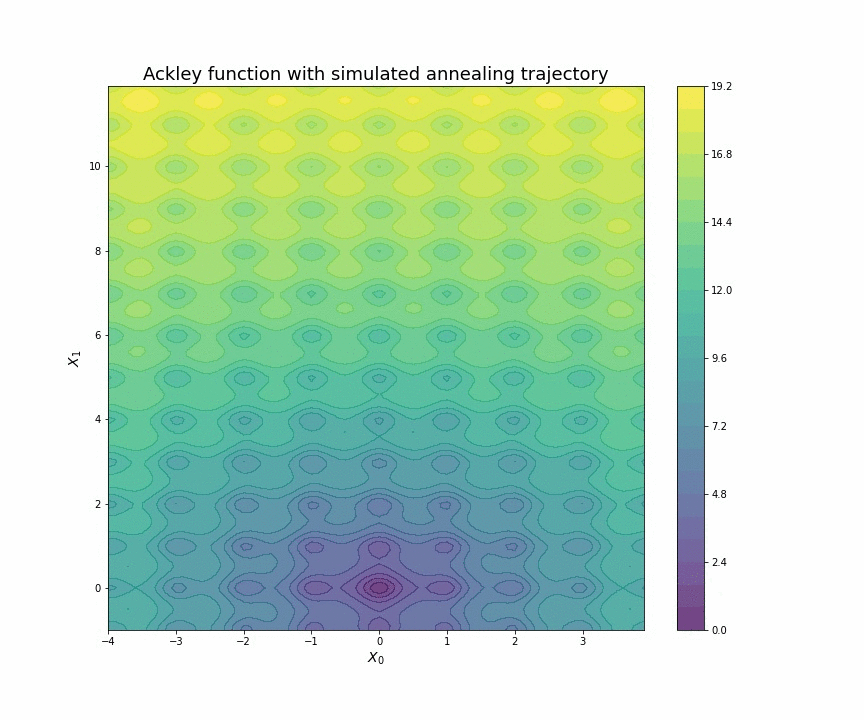

In [12]:
from IPython.display import Image
Image(open('../gifs/ackley.gif','rb').read())

## Problema del Agente Viajero

Dada una cierta cantidad de ciudades que debe visitar un vendedor, se desea minimizar la distancia reccorida por el vendedor, considerando que debe pasar todas y cada una de las ciudades una sola vez.

En la primer gráfica observamos la representación de una ruta aleatoria, que el vendedor deberá tomar para recorrer las 20 ciudades distintas. A simple vista podemos observar que esta ruta está lejos de ser la óptima.

![image](imagenes/Inicial.jpeg)

En la segunda gráfica podemos observar la ruta optimizada que tendría que recorrer el vendedor. Ésta ruta se logró optimizar usando SA para encontrar el minimo global que minimiza la suma de distancias.

![image](imagenes/Optimizado.jpeg)

## Referencias 
- Kirkpatrick, S., Gelatt, C. D., & Vecchi, M. P. (1983). Optimization by Simulated Annealing. Science, 220(4598), 671–680. https://doi.org/10.1126/science.220.4598.671

- Kochnderfer, M. J., & Wheeler, T. A. (2019). Algorithms for optimization. The Mit Press, 128-133.

- Liang, F. (2020, April 21). Optimization Techniques — Simulated Annealing - Towards Data Science. Medium; Towards Data Science. https://towardsdatascience.com/optimization-techniques-simulated-annealing-d6a4785a1de7

- Press, W. H., & Al, E. (2007). Numerical recipes : the art of scientific computing (3rd ed.). Cambridge University Press.

- Surjanovic, S. & Bingham, D. (2013). Virtual Library of Simulation Experiments: Test Functions and Datasets. Retrieved December 13, 2022, from http://www.sfu.ca/~ssurjano.

